In [1]:
import xarray as xr 
import matplotlib.pyplot as plt
import cmocean as cmo 
import pandas as pd 
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import numpy as np
# python -m ipykernel install --user --name schimpy --display-name Schimpy

# Start date 
start_date = '2024-08-13'
end_date = pd.to_datetime(start_date) + pd.Timedelta(seconds=(10*8640))
dates = pd.date_range(start_date, end_date, freq='10s')
dates = dates[0:-1]

label = "trying_to_converge"


import matplotlib.dates as mdates

def format_date_ax(ax):
    ax.xaxis.set_major_locator(mdates.HourLocator(interval=4))
    date_format = mdates.DateFormatter('%m/%d %H:%M')
    ax.xaxis.set_major_formatter(date_format)



In [2]:
# open datasets
hydro = xr.open_dataset('run_hydro/HYDRO.nc', decode_timedelta=False)
truth = xr.open_dataset('forward_phyto/phyto_fake_truth_august_13.nc', decode_timedelta=False)
z = hydro["z"]

NITER = 90

guess = {} 
for i in range(1, NITER):
    guess[i] = xr.open_dataset(f'forward_phyto/forward_{i}_august_13.nc', decode_timedelta=False)

# Read in adjoint 
adjoint = {}
for i in range(1, NITER):
    adjoint[i] = xr.open_dataset(f'backward_lambda/adjoint_{i}_august_13.nc', decode_timedelta=False)

# grad = guess["gamma"].values * adj["lambda"].values

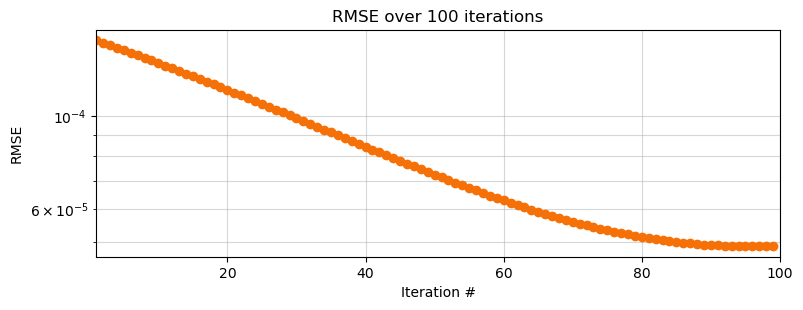

In [ ]:
true = truth.algae1.values.ravel()
guess_algae = [] 

for i in range(1,NITER):
    alg = guess[i].algae1.values.ravel()
    rmse = (np.sqrt(np.mean((true - alg)**2)))
    guess_algae.append(rmse)


fig = plt.figure(figsize=(8,3))
ax = plt.gca() 
ax.plot(np.arange(1, 1+len(guess_algae)), guess_algae, '-o', label='guess algae RMSE', color='#F57108')
ax.grid(alpha = 0.5, which='both') 
ax.set_xlabel("Iteration #")
ax.set_ylabel("RMSE")
ax.set_yscale("log")

ax.set_xlim(1, NITER)
ax.set_title("RMSE over %d iterations" % NITER)
plt.tight_layout()
fig.savefig("rmse_%s.png" % label)

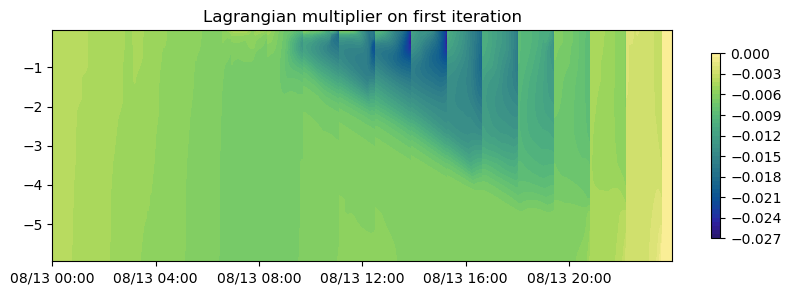

In [8]:
fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, adjoint[1]['lambda'].values.T , levels=50, cmap=cmo.cm.haline)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c, shrink=0.8)
format_date_ax(ax)
plt.title('Lagrangian multiplier on first iteration')
fig.savefig("lagrangian_multiplier_%s.png" % label)

[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.38888889e-06
 -1.38888889e-06 -1.38888889e-06]
-1.2418957407978164e-06 -1.8733077887135327e-06


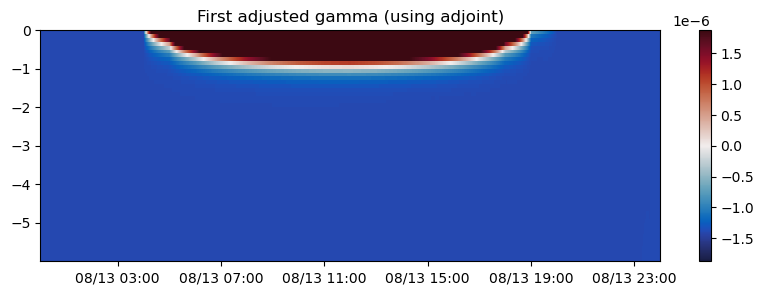

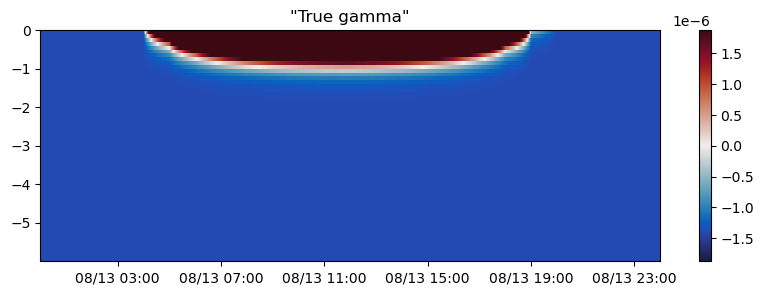

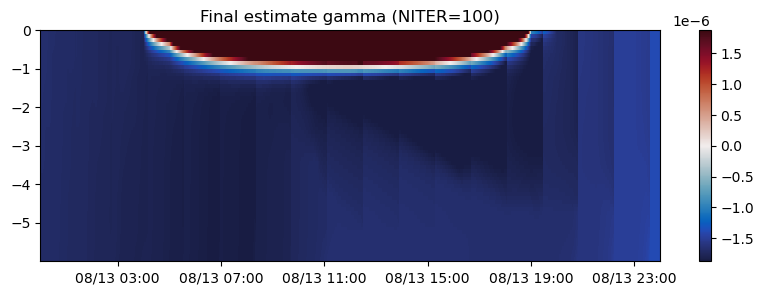

In [10]:

# Contour plots of gamma 
import matplotlib as mpl
import matplotlib.colors as colors

vmax = np.quantile(adjoint[NITER-1].gamma.values.ravel(), 0.9)
vmin = np.quantile(adjoint[NITER-1].gamma.values.ravel(), 0.1)

print(adjoint[NITER-1].gamma.values.ravel())
print(vmax, vmin)
# Find which is bigger
if abs(vmax) > abs(vmin):
    vmax = abs(vmax)
    vmin = -abs(vmax)
else:
    vmin = -abs(vmin)
    vmax = abs(vmin)


divnorm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax )

# Contour plots of gamma 
fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.pcolormesh(dates, -z, adjoint[1].gamma.values.T, cmap=cmo.cm.balance, norm=divnorm)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
format_date_ax(ax)
plt.title('First adjusted gamma (using adjoint)')
fig.savefig("first adjusted gamma %s.png" % label)

fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.pcolormesh(dates, -z, truth.gamma.values.T, cmap=cmo.cm.balance, norm=divnorm)#, vmin=1.5e-7, vmax=1.5e-7)
format_date_ax(ax)
plt.colorbar(c)
plt.title('"True gamma"')
fig.savefig("true gamma %s .png" % label)

# fig = plt.figure(figsize=(10, 3))
# ax = fig.add_subplot(111)
# c = ax.pcolormesh(dates, -z, (adjoint[1].gamma.values.T - adjoint[NITER-1].gamma.values.T),  cmap=cmo.cm.balance, norm=divnorm)#, vmin=1.5e-7, vmax=1.5e-7)
# plt.colorbar(c)
# plt.title('Difference between first and last gamma')
# fig.savefig("difference between first and last gamma %s .png" % label)

fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.pcolormesh(dates, -z, (adjoint[NITER-1].gamma.values.T), cmap=cmo.cm.balance, norm=divnorm)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('Final estimate gamma (NITER=%d)' % NITER)
format_date_ax(ax)
fig.savefig("final gamma estimate %s .png" % label)

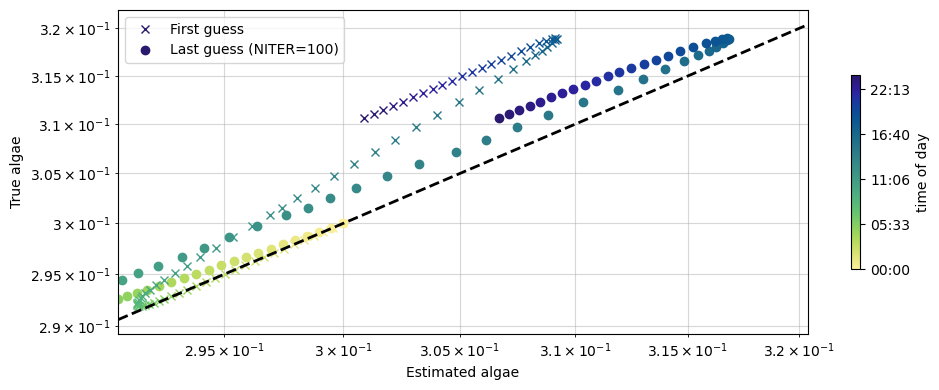

In [12]:
fig, axs = plt.subplots(1, 1, figsize=(10, 4), sharey=True)
# First guess = 
guess1= guess[1].algae1.values
# Last guess =
guessN= guess[NITER-1].algae1.values
# True 
true = truth.algae1.values

cmap = cmo.cm.haline_r 
for i in range(1, 8640, 100):

    guess1_ = guess1[i,:]
    guessN_ = guessN[i,:]
    true_ = true[i,:]

    color = cmap(i/8640)

    axs.plot(sum(guess1_), sum(true_), 'x', color=color)
    axs.plot(sum(guessN_), sum(true_), 'o', color=color)

# Create norm 
norm = mpl.colors.Normalize(vmin=0, vmax=1)
ticks = np.arange(0, 8640, 2000)/8640
cbar= plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs, label='time of day', ticks=ticks, shrink=0.6)

# cbar = fig.colorbar(cax, ticks=[-1, 0, 1])
tick_labels = [dates[i].strftime('%H:%M') for i in range(0, 8640, 2000)]
cbar.ax.set_yticklabels(tick_labels)

axs.plot([], [], 'x', color=color, label='First guess')
axs.plot([], [], 'o', color=color, label='Last guess (NITER=%d)' % NITER)

axs.set_xscale('log')
axs.set_yscale('log')

# Get limits of the plot
xlim = axs.get_xlim()
ylim = axs.get_ylim()

# Set limits equal to each other
axs.set_xlim(ylim) 
axs.grid(alpha=0.5, which='both')
axs.plot(ylim, ylim, 'k--', lw=2)
axs.legend()
axs.set_xlabel('Estimated algae')
axs.set_ylabel('True algae')
plt.tight_layout()
fig.savefig("guess_vs_truth_%s.png" % label)

In [ ]:
fig = plt.figure() 
ax = fig.add_subplot(111)

# Calculate R^2


In [107]:
frames = []

start = 0
end = 8640 
spacing = 6 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    h1 = go.Scatter(x=guess[NITER-1]["algae1"][i,:]*1e6, y=-z, name= "Best guess", mode='lines', line=dict(width=2, color="blue"))  
    h3 = go.Scatter(x=guess[1]["algae1"][i,:]*1e6, y=-z, name= "Guess gamma", mode='lines', line=dict(width=2, color="pink"))
    h2 = go.Scatter(x=truth["algae1"][i,:]*1e6, y=-z, name= "True gamma",  mode='lines', line=dict(width=2, color="green"))  
    frames.append(go.Frame(data=[h1, h2, h3], name=str(dates[i])))

# Initial figure
i = 0 
h1 = go.Scatter(x=guess[NITER-1]["algae1"][i,:]*1e6, y=-z, name= "Best guess", mode='lines', line=dict(width=2, color="blue"))  
h2 = go.Scatter(x=truth["algae1"][i,:]*1e6, y=-z, name= "Truth",  mode='lines', line=dict(width=2, color="green"))   
h3 = go.Scatter(x=guess[1]["algae1"][i,:]*1e6, y=-z, name= "First gamma", mode='lines', line=dict(width=2, color="pink"))

fig = go.Figure( data=[h1, h2, h3],
                layout=go.Layout(
                    title='Algae Concentration in the Water Column',
                    xaxis=dict(range=[0, 2e4], title='Algae Concentration (cells/mL)'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


In [94]:
frames = []

start = 0
end = 8460 
spacing = 6 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    h1 = go.Scatter(x=guess[NITER-1]["gamma"][i,:], y=-z, name= "Best guess", mode='lines', line=dict(width=2, color="blue"))  
    h3 = go.Scatter(x=guess[1]["gamma"][i,:], y=-z, name= "Guess gamma", mode='lines', line=dict(width=2, color="pink"))
    h2 = go.Scatter(x=truth["gamma"][i,:], y=-z, name= "True gamma",  mode='lines', line=dict(width=2, color="green"))  
    frames.append(go.Frame(data=[h1, h2, h3], name=str(dates[i])))

# Initial figure
i = 0 
h1 = go.Scatter(x=guess[NITER-1]["gamma"][i,:], y=-z, name= "Best guess", mode='lines', line=dict(width=2, color="blue"))  
h2 = go.Scatter(x=truth["gamma"][i,:], y=-z, name= "Truth",  mode='lines', line=dict(width=2, color="green"))   
h3 = go.Scatter(x=guess[1]["gamma"][i,:], y=-z, name= "First gamma", mode='lines', line=dict(width=2, color="pink"))

fig = go.Figure( data=[h1, h2, h3],
                layout=go.Layout(
                    title='growth (gamma) in the Water Column',
                    xaxis=dict(range=[-2e-5, 2e-5], title='growth [-]'), #range=[0, 1e-1],
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


In [95]:
frames = []

start = 8630
end = 0
spacing = -50 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift

adj = adjoint[NITER-1]
for i in range(start, end, spacing):
    # print(adj["lambda"][i,:][0:5].values)
    h1 = go.Scatter(x=adj["lambda"][i,:], y=-z, name= "Adjoint", mode='lines', line=dict(width=2, color="blue"))  
    frames.append(go.Frame(data=[h1], name=str(dates[i])))

# Initial figure
h1 = go.Scatter(x=adj["lambda"][start,:], y=-z, name= "Adjoint", mode='lines', line=dict(width=2, color="blue"))  
fig = go.Figure( data=[h1],
                layout=go.Layout(
                    title='Adjoint variable',
                    xaxis=dict(range=[-0.01, 0.01], title='Adjoint Variable [-]'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


In [96]:

plt.figure(figsize=(4, 5))

i = -1 
diff = guess["algae1"][i,:] - truth["algae1"][i,:]

plt.plot(diff, -z, linewidth=2)
plt.plot(adj["lambda"][i,:]/2 , -z, '--',linewidth=2)
# plt.plot(flip(diff), -z, linewidth=2)
plt.title(f"Cells/mL at time %s" % dates[-1])
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.grid(alpha=0.5)
plt.show()

print(adj["lambda"].shape)


KeyError: 'algae1'

<Figure size 400x500 with 0 Axes>

In [ ]:
# TURBULENT DIFFUSIVITY

frames = []

start = 0
end = 8998
spacing = 50 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    h1 = go.Scatter(x=hydro["Kz"][i,:], y=-z, name= "Turbulent Diffusivity", mode='lines', line=dict(width=2, color="blue"))  
    frames.append(go.Frame(data=[h1], name=str(dates[i])))

# Initial figure
h1 = go.Scatter(x=hydro["Kz"][i,:], y=-z, name= "Turbulent Diffusivity", mode='lines', line=dict(width=2, color="blue"))  
fig = go.Figure( data=[h1],
                layout=go.Layout(
                    title='TURBULENT DIFFUSIVITY',
                    xaxis=dict(range=[0, 0.01], title='Adjoint Variable [-]'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


<xarray.Dataset> Size: 5MB
Dimensions:  (z: 60, time: 9999)
Coordinates:
  * z        (z) float32 240B 5.95 5.85 5.75 5.65 5.55 ... 0.35 0.25 0.15 0.05
  * time     (time) timedelta64[ns] 80kB 00:00:01 00:00:02 ... 02:46:38 02:46:39
Data variables:
    lambda   (time, z) float64 5MB ...


/tmp/ipykernel_1299565/2487831615.py:1: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('adjoint.nc')


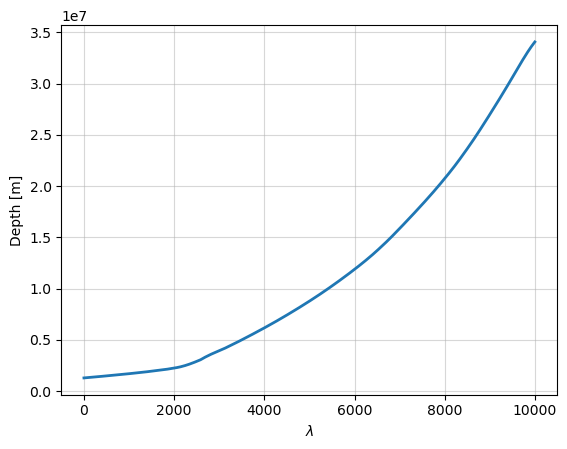

2024-08-10 05:33:00
2024-08-10 05:16:20
2024-08-10 04:59:40
2024-08-10 04:43:00
2024-08-10 04:26:20
2024-08-10 04:09:40
2024-08-10 03:53:00
2024-08-10 03:36:20
2024-08-10 03:19:40
2024-08-10 03:03:00
2024-08-10 02:46:20
2024-08-10 02:29:40
2024-08-10 02:13:00
2024-08-10 01:56:20
2024-08-10 01:39:40
2024-08-10 01:23:00
2024-08-10 01:06:20
2024-08-10 00:49:40
2024-08-10 00:33:00
2024-08-10 00:16:20


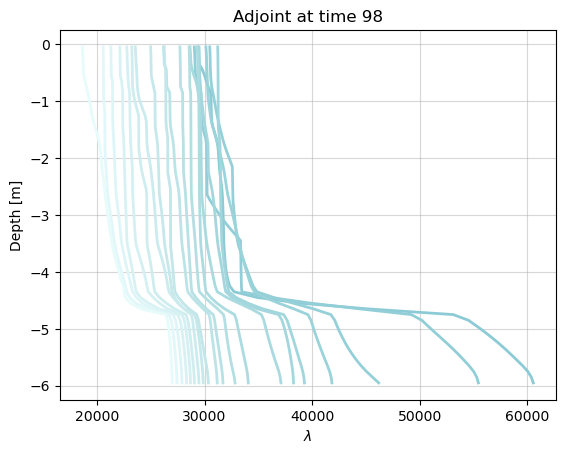

In [ ]:

ds = xr.open_dataset('adjoint.nc')

z = -ds['z'].values
time = ds['time'].values

plt.figure()
plt.plot(ds['lambda'].sum(dim='z'), linewidth=2)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.grid(alpha=0.5)
plt.show()




plt.figure()
for i in range(1998, 0, -100):
    print(dates[i])
    plt.plot(ds['lambda'].isel(time=i), z, color=cmo.cm.ice_r(i/10000), linewidth=2)
    # print("At time %d, sum(lambda) = %f" % (i, ds['lambda'].isel(time=i).sum()))
plt.title(f"Adjoint at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
# ax.set_xlim(-1e4,1e4)
ax.grid(alpha=0.5)
plt.show()


/tmp/ipykernel_1299565/4253105365.py:6: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('../forward_phyto/phyto_TRUTH.nc')


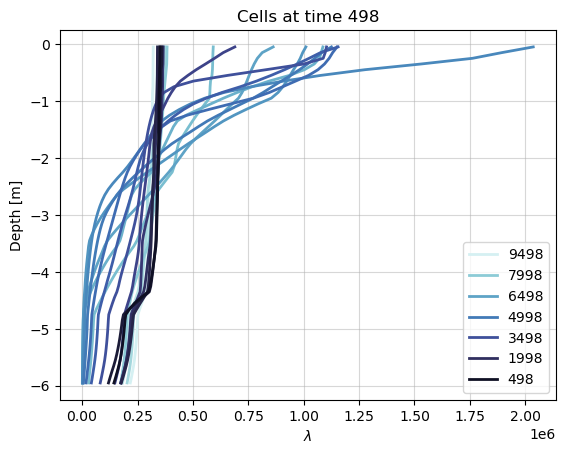

In [ ]:
import matplotlib.pyplot as plt
import cmocean as cmo 



ds = xr.open_dataset('../forward_phyto/phyto_TRUTH.nc')

z = ds['z'].values
time = ds['time'].values


plt.figure()
for i in range(9998, 0, -500):
    if i%3 == 0 :
        plt.plot(ds['algae1'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2, label=i)
    else : 
        plt.plot(ds['algae1'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2)
plt.title(f"Cells at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.legend()
# ax.set_xlim(0,4)
ax.grid(alpha=0.5)
plt.show()

At time 9998, sum(lambda) = 0.503609
At time 9498, sum(lambda) = 0.251445
At time 8998, sum(lambda) = 0.103097
At time 8498, sum(lambda) = 0.213268
At time 7998, sum(lambda) = 0.164009
At time 7498, sum(lambda) = 0.132224
At time 6998, sum(lambda) = 0.036655
At time 6498, sum(lambda) = 0.009403
At time 5998, sum(lambda) = 0.013678
At time 5498, sum(lambda) = 0.002634
At time 4998, sum(lambda) = 0.004618
At time 4498, sum(lambda) = 0.006982
At time 3998, sum(lambda) = 0.003122
At time 3498, sum(lambda) = 0.009544
At time 2998, sum(lambda) = 0.007737
At time 2498, sum(lambda) = 0.166115
At time 1998, sum(lambda) = 0.126441
At time 1498, sum(lambda) = 0.292678
At time 998, sum(lambda) = 0.359232
At time 498, sum(lambda) = 0.447689


/tmp/ipykernel_1702945/913905150.py:8: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('../run_hydro/HYDRO.nc')


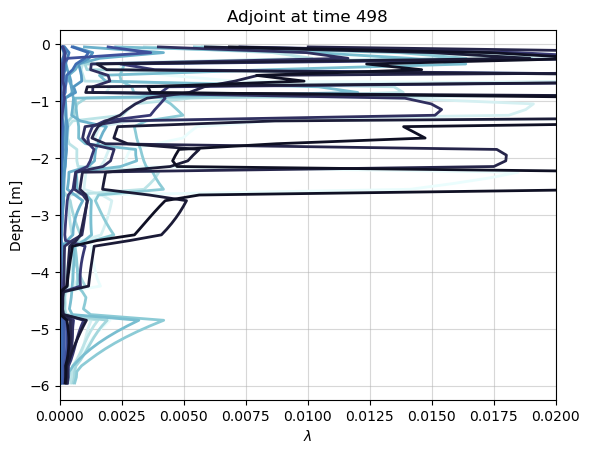

In [ ]:
import matplotlib.pyplot as plt
import cmocean as cmo 

z = ds['z'].values
time = ds['time'].values


ds = xr.open_dataset('../run_hydro/HYDRO.nc')

plt.figure()
for i in range(9998, 0, -200):
    plt.plot(ds['Kz'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2)
    print("At time %d, sum(lambda) = %f" % (i, ds['Kz'].isel(time=i).sum()))
plt.title(f"Adjoint at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.set_xlim(0,2e-2)
ax.grid(alpha=0.5)
plt.show()